In [1]:

# imports
import os
import sys
import types
import json
import base64

# figure size/format
fig_width = 7
fig_height = 5
fig_format = 'retina'
fig_dpi = 96
interactivity = ''
is_shiny = False
is_dashboard = False
plotly_connected = True

# matplotlib defaults / format
try:
  import matplotlib.pyplot as plt
  plt.rcParams['figure.figsize'] = (fig_width, fig_height)
  plt.rcParams['figure.dpi'] = fig_dpi
  plt.rcParams['savefig.dpi'] = "figure"
  from IPython.display import set_matplotlib_formats
  set_matplotlib_formats(fig_format)
except Exception:
  pass

# plotly use connected mode
try:
  import plotly.io as pio
  if plotly_connected:
    pio.renderers.default = "notebook_connected"
  else:
    pio.renderers.default = "notebook"
  for template in pio.templates.keys():
    pio.templates[template].layout.margin = dict(t=30,r=0,b=0,l=0)
except Exception:
  pass

# disable itables paging for dashboards
if is_dashboard:
  try:
    from itables import options
    options.dom = 'fiBrtlp'
    options.maxBytes = 1024 * 1024
    options.language = dict(info = "Showing _TOTAL_ entries")
    options.classes = "display nowrap compact"
    options.paging = False
    options.searching = True
    options.ordering = True
    options.info = True
    options.lengthChange = False
    options.autoWidth = False
    options.responsive = True
    options.keys = True
    options.buttons = []
  except Exception:
    pass
  
  try:
    import altair as alt
    # By default, dashboards will have container sized
    # vega visualizations which allows them to flow reasonably
    theme_sentinel = '_quarto-dashboard-internal'
    def make_theme(name):
        nonTheme = alt.themes._plugins[name]    
        def patch_theme(*args, **kwargs):
            existingTheme = nonTheme()
            if 'height' not in existingTheme:
              existingTheme['height'] = 'container'
            if 'width' not in existingTheme:
              existingTheme['width'] = 'container'

            if 'config' not in existingTheme:
              existingTheme['config'] = dict()
            
            # Configure the default font sizes
            title_font_size = 15
            header_font_size = 13
            axis_font_size = 12
            legend_font_size = 12
            mark_font_size = 12
            tooltip = False

            config = existingTheme['config']

            # The Axis
            if 'axis' not in config:
              config['axis'] = dict()
            axis = config['axis']
            if 'labelFontSize' not in axis:
              axis['labelFontSize'] = axis_font_size
            if 'titleFontSize' not in axis:
              axis['titleFontSize'] = axis_font_size  

            # The legend
            if 'legend' not in config:
              config['legend'] = dict()
            legend = config['legend']
            if 'labelFontSize' not in legend:
              legend['labelFontSize'] = legend_font_size
            if 'titleFontSize' not in legend:
              legend['titleFontSize'] = legend_font_size  

            # The header
            if 'header' not in config:
              config['header'] = dict()
            header = config['header']
            if 'labelFontSize' not in header:
              header['labelFontSize'] = header_font_size
            if 'titleFontSize' not in header:
              header['titleFontSize'] = header_font_size    

            # Title
            if 'title' not in config:
              config['title'] = dict()
            title = config['title']
            if 'fontSize' not in title:
              title['fontSize'] = title_font_size

            # Marks
            if 'mark' not in config:
              config['mark'] = dict()
            mark = config['mark']
            if 'fontSize' not in mark:
              mark['fontSize'] = mark_font_size

            # Mark tooltips
            if tooltip and 'tooltip' not in mark:
              mark['tooltip'] = dict(content="encoding")

            return existingTheme
            
        return patch_theme

    # We can only do this once per session
    if theme_sentinel not in alt.themes.names():
      for name in alt.themes.names():
        alt.themes.register(name, make_theme(name))
      
      # register a sentinel theme so we only do this once
      alt.themes.register(theme_sentinel, make_theme('default'))
      alt.themes.enable('default')

  except Exception:
    pass

# enable pandas latex repr when targeting pdfs
try:
  import pandas as pd
  if fig_format == 'pdf':
    pd.set_option('display.latex.repr', True)
except Exception:
  pass

# interactivity
if interactivity:
  from IPython.core.interactiveshell import InteractiveShell
  InteractiveShell.ast_node_interactivity = interactivity

# NOTE: the kernel_deps code is repeated in the cleanup.py file
# (we can't easily share this code b/c of the way it is run).
# If you edit this code also edit the same code in cleanup.py!

# output kernel dependencies
kernel_deps = dict()
for module in list(sys.modules.values()):
  # Some modules play games with sys.modules (e.g. email/__init__.py
  # in the standard library), and occasionally this can cause strange
  # failures in getattr.  Just ignore anything that's not an ordinary
  # module.
  if not isinstance(module, types.ModuleType):
    continue
  path = getattr(module, "__file__", None)
  if not path:
    continue
  if path.endswith(".pyc") or path.endswith(".pyo"):
    path = path[:-1]
  if not os.path.exists(path):
    continue
  kernel_deps[path] = os.stat(path).st_mtime
print(json.dumps(kernel_deps))

# set run_path if requested
run_path = 'L1VzZXJzL2tuYWFwdGltZS9Ecm9wYm94L3dvcmtzaG9wcy93b3Jrc2hvcC1uZXJzYTI1L25vdGVib29rcw=='
if run_path:
  # hex-decode the path
  run_path = base64.b64decode(run_path.encode("utf-8")).decode("utf-8")
  os.chdir(run_path)

# reset state
%reset

# shiny
# Checking for shiny by using False directly because we're after the %reset. We don't want
# to set a variable that stays in global scope.
if False:
  try:
    import htmltools as _htmltools
    import ast as _ast

    _htmltools.html_dependency_render_mode = "json"

    # This decorator will be added to all function definitions
    def _display_if_has_repr_html(x):
      try:
        # IPython 7.14 preferred import
        from IPython.display import display, HTML
      except:
        from IPython.core.display import display, HTML

      if hasattr(x, '_repr_html_'):
        display(HTML(x._repr_html_()))
      return x

    # ideally we would undo the call to ast_transformers.append
    # at the end of this block whenver an error occurs, we do 
    # this for now as it will only be a problem if the user 
    # switches from shiny to not-shiny mode (and even then likely
    # won't matter)
    import builtins
    builtins._display_if_has_repr_html = _display_if_has_repr_html

    class _FunctionDefReprHtml(_ast.NodeTransformer):
      def visit_FunctionDef(self, node):
        node.decorator_list.insert(
          0,
          _ast.Name(id="_display_if_has_repr_html", ctx=_ast.Load())
        )
        return node

      def visit_AsyncFunctionDef(self, node):
        node.decorator_list.insert(
          0,
          _ast.Name(id="_display_if_has_repr_html", ctx=_ast.Load())
        )
        return node

    ip = get_ipython()
    ip.ast_transformers.append(_FunctionDefReprHtml())

  except:
    pass

def ojs_define(**kwargs):
  import json
  try:
    # IPython 7.14 preferred import
    from IPython.display import display, HTML
  except:
    from IPython.core.display import display, HTML

  # do some minor magic for convenience when handling pandas
  # dataframes
  def convert(v):
    try:
      import pandas as pd
    except ModuleNotFoundError: # don't do the magic when pandas is not available
      return v
    if type(v) == pd.Series:
      v = pd.DataFrame(v)
    if type(v) == pd.DataFrame:
      j = json.loads(v.T.to_json(orient='split'))
      return dict((k,v) for (k,v) in zip(j["index"], j["data"]))
    else:
      return v

  v = dict(contents=list(dict(name=key, value=convert(value)) for (key, value) in kwargs.items()))
  display(HTML('<script type="ojs-define">' + json.dumps(v) + '</script>'), metadata=dict(ojs_define = True))
globals()["ojs_define"] = ojs_define
globals()["__spec__"] = None

{"/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/importlib/_bootstrap.py": 1749048095.180818, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/importlib/_bootstrap_external.py": 1749048095.186942, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/zipimport.py": 1749048093.681998, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/codecs.py": 1749048093.1941013, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/encodings/aliases.py": 1749048094.2440884, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/encodings/__init__.py": 1749048094.2403631, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/encodings/utf_8.py": 1749048094.6482184, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/abc.py": 1749048093.1029341, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/io.py": 1749048093.3712983, "/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/stat.py": 1749048093.571816, "/Users/knaaptime/miniforge3/envs/nersa25/lib/pyth

In [2]:
import geopandas as gpd
import numpy as np
import pandas as pd
from geosnap import DataStore
from geosnap import io as gio
from libpysal.graph import Graph
from spint.gravity import Attraction, Doubly, Gravity, Production
from lonboard import Map, PolygonLayer,ScatterplotLayer, basemap, viz
from lonboard.experimental import ArcLayer, TripsLayer
from lonboard.layer_extension import BrushingExtension
from mapclassify.util import get_color_array
import statsmodels.formula.api as smf
from statsmodels.api import families
import networkx as nx
from formulaic import Formula

OMP: Info #276: omp_set_nested routine deprecated, please use omp_set_max_active_levels instead.


In [3]:
datasets = DataStore()

dc = gio.get_acs(datasets, state_fips="11", years=2021, level="tract")

/Users/knaaptime/Dropbox/projects/geosnap/geosnap/io/util.py:273: UserWarning: Unable to find local adjustment year for 2021. Attempting from online data
  warn(
/Users/knaaptime/Dropbox/projects/geosnap/geosnap/io/constructors.py:218: UserWarning: Currency columns unavailable at this resolution; not adjusting for inflation
  warn(


In [4]:
dc.head()

,geoid,n_mexican_pop,n_cuban_pop,n_puerto_rican_pop,n_russian_pop,n_italian_pop,n_german_pop,n_irish_pop,n_scandaniavian_pop,n_foreign_born_pop,...,p_poverty_rate,p_poverty_rate_over_65,p_poverty_rate_children,p_poverty_rate_white,p_poverty_rate_black,p_poverty_rate_hispanic,p_poverty_rate_native,p_poverty_rate_asian,geometry,year
0,11001000101,102.0,0.0,0.0,0.0,68.0,26.0,59.0,0.0,149.0,...,2.341920,0.000000,0.000000,2.341920,0.000000,2.341920,0.0,0.0,"MULTIPOLYGON (((-77.05714 38.91054, -77.05702 ...",2021
1,11001000102,134.0,0.0,0.0,68.0,56.0,14.0,146.0,0.0,746.0,...,6.724512,1.487450,1.456461,4.834211,0.000000,0.000000,0.0,0.0,"MULTIPOLYGON (((-77.06927 38.90058, -77.06871 ...",2021
2,11001000201,152.0,0.0,109.0,5.0,45.0,8.0,98.0,0.0,731.0,...,19.402985,0.000000,0.000000,16.417910,2.985075,0.000000,0.0,0.0,"MULTIPOLYGON (((-77.07927 38.91268, -77.07902 ...",2021
3,11001000202,42.0,46.0,58.0,61.0,91.0,56.0,220.0,0.0,793.0,...,12.948793,2.472042,0.000000,10.829900,0.588582,0.824014,0.0,0.0,"MULTIPOLYGON (((-77.07991 38.90507, -77.07989 ...",2021
4,11001000300,150.0,103.0,8.0,33.0,220.0,74.0,71.0,0.0,1308.0,...,13.308750,0.301710,0.201140,12.504190,0.000000,0.620181,0.0,0.0,"MULTIPOLYGON (((-77.08262 38.9212, -77.08256 3...",2021


<Axes: >

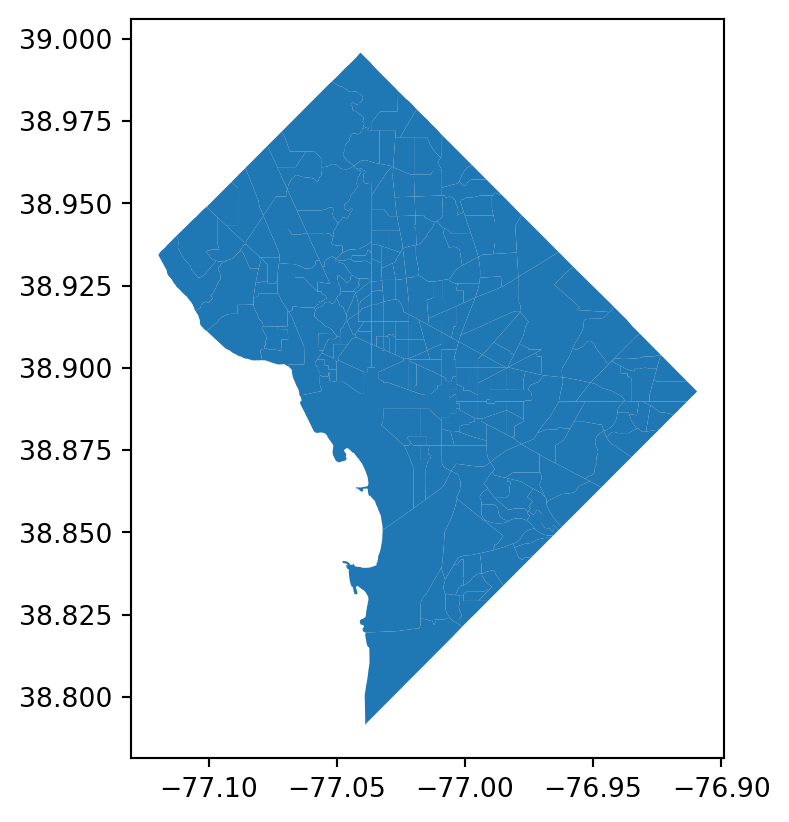

In [5]:
dc.plot()

In [6]:
dc_flows = pd.read_csv(
    "https://lehd.ces.census.gov/data/lodes/LODES8/dc/od/dc_od_main_JT00_2022.csv.gz",
    converters={"w_geocode": str, "h_geocode": str},
    low_memory=False,
    encoding="latin1",
)

In [7]:
dc_flows

,w_geocode,h_geocode,S000,SA01,SA02,SA03,SE01,SE02,SE03,SI01,SI02,SI03,createdate
0,110010001011000,110010001011000,1,1,0,0,0,0,1,0,1,0,20240920
1,110010001011000,110010001011001,3,1,2,0,0,0,3,0,0,3,20240920
2,110010001011000,110010001011003,1,0,0,1,0,0,1,0,0,1,20240920
3,110010001011000,110010001011009,1,1,0,0,0,0,1,0,1,0,20240920
4,110010001011000,110010001021011,1,0,0,1,0,0,1,0,1,0,20240920
...,...,...,...,...,...,...,...,...,...,...,...,...,...
169140,110019800001187,110010094004008,1,0,1,0,0,0,1,0,0,1,20240920
169141,110019800001187,110010095071000,1,0,1,0,0,0,1,0,0,1,20240920
169142,110019800001187,110010099021011,1,0,1,0,0,0,1,0,0,1,20240920
169143,110019800001192,110010047041001,1,0,1,0,1,0,0,0,0,1,20240920


In [8]:
dc_flows["w_tr_geocode"] = dc_flows["w_geocode"].str[:11]
dc_flows["h_tr_geocode"] = dc_flows["h_geocode"].str[:11]

dc_flows = dc_flows[["w_geocode", "h_geocode", "w_tr_geocode", "h_tr_geocode", "S000"]]

In [9]:
dc_flows = (
    dc_flows.groupby(["w_tr_geocode", "h_tr_geocode"])["S000"].sum().reset_index()
)

In [10]:
dc_flows

,w_tr_geocode,h_tr_geocode,S000
0,11001000101,11001000101,22
1,11001000101,11001000102,8
2,11001000101,11001000202,6
3,11001000101,11001000300,3
4,11001000101,11001000501,1
...,...,...,...
23301,11001980000,11001010900,26
23302,11001980000,11001011001,91
23303,11001980000,11001011002,50
23304,11001980000,11001011100,90


In [11]:
dc_flow_graph = Graph.from_adjacency(
    adjacency=dc_flows,
    focal_col="h_tr_geocode",
    neighbor_col="w_tr_geocode",
    weight_col="S000",
)

In [12]:
dc_flow_graph.summary()

Graph Summary Statistics
========================
Graph indexed by:
 ['11001000101', '11001000102', '11001000202', '1100100030...]
==============================================================
Number of nodes:                                           206
Number of edges:                                         23306
Number of connected components:                              1
Number of isolates:                                          0
Number of non-zero edges:                                23306
Percentage of non-zero edges:                           54.92%
Number of asymmetries:                            NA
--------------------------------------------------------------
Cardinalities
==============================================================
Mean:                     113    25%:                      102
Standard deviation:        24    50%:                      115
Min:                       23    75%:                      131
Max:                      159
--------------------------------------------------------------
Weights
==============================================================
Mean:                       9    25%:                        1
Standard deviation:        20    50%:                        3
Min:                        1    75%:                        7
Max:                      361
--------------------------------------------------------------
Sum of weights
==============================================================
S0:                                                     206135
S1:                                                   12398975
S2:                                                 2363152954
--------------------------------------------------------------
Traces
==============================================================
GG:                                                     915878
G'G:                                                  11483097
G'G + GG:                                             12398975

In [13]:
dc_flow_graph.adjacency.head()

focal        neighbor   
11001000101  11001000101    22
             11001000102    23
             11001000202    12
             11001000703     1
             11001000704     1
Name: weight, dtype: int64

In [14]:
idx = dc_flow_graph.unique_ids

In [15]:
dc_centroids = dc.set_geometry(dc.centroid)
dc_centroids = dc_centroids.set_index("geoid").reindex(idx)

/var/folders/j8/5bgcw6hs7cqcbbz48d6bsftw0000gp/T/ipykernel_31528/898227089.py:1: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  dc_centroids = dc.set_geometry(dc.centroid)


In [16]:
dc_centroids.shape  # matches our Graph.n

(206, 157)

In [17]:
flows = dc_flow_graph.adjacency.reset_index()

In [18]:
flows

,focal,neighbor,weight
0,11001000101,11001000101,22
1,11001000101,11001000102,23
2,11001000101,11001000202,12
3,11001000101,11001000703,1
4,11001000101,11001000704,1
...,...,...,...
23301,11001980000,11001009400,1
23302,11001980000,11001009510,2
23303,11001980000,11001010100,3
23304,11001980000,11001010202,2


In [19]:
# mapping of geoid to (point) geometry
dc.centroid.head()

/var/folders/j8/5bgcw6hs7cqcbbz48d6bsftw0000gp/T/ipykernel_31528/4023599085.py:2: UserWarning: Geometry is in a geographic CRS. Results from 'centroid' are likely incorrect. Use 'GeoSeries.to_crs()' to re-project geometries to a projected CRS before this operation.

  dc.centroid.head()


0    POINT (-77.05459 38.90863)
1    POINT (-77.06127 38.90555)
2    POINT (-77.07434 38.90922)
3    POINT (-77.06946 38.90617)
4    POINT (-77.07577 38.91755)
dtype: geometry

In [20]:
flows['focal'] = flows['focal'].replace(dc_centroids['geometry'].to_dict())
flows['neighbor'] = flows['neighbor'].replace(dc_centroids['geometry'].to_dict())

In [21]:
flows

,focal,neighbor,weight
0,POINT (-77.0545901773603 38.90863168678613),POINT (-77.0545901773603 38.90863168678613),22
1,POINT (-77.0545901773603 38.90863168678613),POINT (-77.06126938548466 38.90554704444118),23
2,POINT (-77.0545901773603 38.90863168678613),POINT (-77.06945761360377 38.90616754177441),12
3,POINT (-77.0545901773603 38.90863168678613),POINT (-77.07904623332543 38.92909409426648),1
4,POINT (-77.0545901773603 38.90863168678613),POINT (-77.07523846048979 38.93002154576946),1
...,...,...,...
23301,POINT (-77.03521796878309 38.88015568912712),POINT (-76.97424646610372 38.936806296574765),1
23302,POINT (-77.03521796878309 38.88015568912712),POINT (-77.00462558924458 38.945597917488946),2
23303,POINT (-77.03521796878309 38.88015568912712),POINT (-77.03184718492626 38.90269707590609),3
23304,POINT (-77.03521796878309 38.88015568912712),POINT (-77.0244550492709 38.88309525105518),2


In [22]:
origins = gpd.GeoSeries(flows.focal).get_coordinates().values

destinations = (
    gpd.GeoSeries(flows.neighbor).get_coordinates().values
)

In [23]:
origins

array([[-77.05459018,  38.90863169],
       [-77.05459018,  38.90863169],
       [-77.05459018,  38.90863169],
       ...,
       [-77.03521797,  38.88015569],
       [-77.03521797,  38.88015569],
       [-77.03521797,  38.88015569]], shape=(23306, 2))

In [24]:
from shapely import LineString

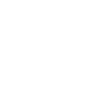

In [25]:
LineString([flows['focal'][0], flows['neighbor'][0]])

In [26]:
lines = gpd.GeoSeries([LineString([row[1]['focal'], row[1]['neighbor']]) for row in flows.iterrows()], crs=4326)

In [27]:
flow_lines =gpd.GeoDataFrame(flows['weight'], geometry=lines)

In [28]:
flow_lines

,weight,geometry
0,22,"LINESTRING (-77.05459 38.90863, -77.05459 38.9..."
1,23,"LINESTRING (-77.05459 38.90863, -77.06127 38.9..."
2,12,"LINESTRING (-77.05459 38.90863, -77.06946 38.9..."
3,1,"LINESTRING (-77.05459 38.90863, -77.07905 38.9..."
4,1,"LINESTRING (-77.05459 38.90863, -77.07524 38.9..."
...,...,...
23301,1,"LINESTRING (-77.03522 38.88016, -76.97425 38.9..."
23302,2,"LINESTRING (-77.03522 38.88016, -77.00463 38.9..."
23303,3,"LINESTRING (-77.03522 38.88016, -77.03185 38.9..."
23304,2,"LINESTRING (-77.03522 38.88016, -77.02446 38.8..."


In [29]:
lines.explore()

In [30]:
viz(flow_lines)

Map(basemap_style=<CartoBasemap.DarkMatter: 'https://basemaps.cartocdn.com/gl/dark-matter-gl-style/style.json'…

In [31]:
dc_flow_graph.adjacency

focal        neighbor   
11001000101  11001000101    22
             11001000102    23
             11001000202    12
             11001000703     1
             11001000704     1
                            ..
11001980000  11001009400     1
             11001009510     2
             11001010100     3
             11001010202     2
             11001980000     3
Name: weight, Length: 23306, dtype: int64

In [32]:
flow_lines[['weight', 'geometry']]

,weight,geometry
0,22,"LINESTRING (-77.05459 38.90863, -77.05459 38.9..."
1,23,"LINESTRING (-77.05459 38.90863, -77.06127 38.9..."
2,12,"LINESTRING (-77.05459 38.90863, -77.06946 38.9..."
3,1,"LINESTRING (-77.05459 38.90863, -77.07905 38.9..."
4,1,"LINESTRING (-77.05459 38.90863, -77.07524 38.9..."
...,...,...
23301,1,"LINESTRING (-77.03522 38.88016, -76.97425 38.9..."
23302,2,"LINESTRING (-77.03522 38.88016, -77.00463 38.9..."
23303,3,"LINESTRING (-77.03522 38.88016, -77.03185 38.9..."
23304,2,"LINESTRING (-77.03522 38.88016, -77.02446 38.8..."


In [33]:
brushing_extension = BrushingExtension()
brushing_radius = 300

arc_layer = ArcLayer(
    table=flow_lines[['weight', 'geometry']].to_arrow(),
    get_width=flow_lines.weight.apply(lambda x: x**.7),
    get_source_position=origins,
    get_target_position=destinations,
    opacity=0.4,
    pickable=False,
    extensions=[brushing_extension],
    brushing_radius=brushing_radius,
    get_source_color=get_color_array(flow_lines.weight**.7, scheme='fisher_jenks', k=10, cmap='inferno_r'),
    get_target_color=get_color_array(flow_lines.weight**.7, scheme='fisher_jenks', k=10, cmap='inferno_r')
)

source_gdf = gpd.GeoDataFrame(geometry=flows["focal"], crs=4326)
target_gdf = gpd.GeoDataFrame(geometry=flows["neighbor"], crs=4326)

tgt = ScatterplotLayer.from_geopandas(
    target_gdf,
    radius_scale=30,
    pickable=True,
    stroked=False,
    filled=True,
    line_width_min_pixels=2,
    extensions=[brushing_extension],
    brushing_radius=brushing_radius,
)

src = ScatterplotLayer.from_geopandas(
    source_gdf,
    radius_scale=15,
    pickable=False,
    stroked=False,
    filled=True,
    line_width_min_pixels=2,
    extensions=[brushing_extension],
    brushing_radius=brushing_radius,
)

bounds = PolygonLayer.from_geopandas(
    dc,
    get_fill_color=[255, 255, 255, 200],
    stroked=True,
    line_width_min_pixels=0.5,
    pickable=False,
    opacity=0.3
)

ogb = ScatterplotLayer.from_geopandas(
    source_gdf,
    get_fill_color=[255, 255, 255, 200],
    stroked=True,
    line_width_min_pixels=0.5,
    pickable=False,
)

gmap = Map(layers=[bounds, src, tgt, arc_layer,ogb], picking_radius=500)
gmap.to_html('dc_flow_orig_orient.html')


gmap

/Users/knaaptime/miniforge3/envs/nersa25/lib/python3.12/site-packages/lonboard/_geoarrow/ops/reproject.py:113: UserWarning: Input being reprojected to EPSG:4326 CRS.
Lonboard is only able to render data in EPSG:4326 projection.
  warnings.warn(


Map(custom_attribution='', layers=(PolygonLayer(get_fill_color=[255, 255, 255, 200], line_width_min_pixels=0.5…

In [34]:
flows

,focal,neighbor,weight
0,POINT (-77.0545901773603 38.90863168678613),POINT (-77.0545901773603 38.90863168678613),22
1,POINT (-77.0545901773603 38.90863168678613),POINT (-77.06126938548466 38.90554704444118),23
2,POINT (-77.0545901773603 38.90863168678613),POINT (-77.06945761360377 38.90616754177441),12
3,POINT (-77.0545901773603 38.90863168678613),POINT (-77.07904623332543 38.92909409426648),1
4,POINT (-77.0545901773603 38.90863168678613),POINT (-77.07523846048979 38.93002154576946),1
...,...,...,...
23301,POINT (-77.03521796878309 38.88015568912712),POINT (-76.97424646610372 38.936806296574765),1
23302,POINT (-77.03521796878309 38.88015568912712),POINT (-77.00462558924458 38.945597917488946),2
23303,POINT (-77.03521796878309 38.88015568912712),POINT (-77.03184718492626 38.90269707590609),3
23304,POINT (-77.03521796878309 38.88015568912712),POINT (-77.0244550492709 38.88309525105518),2


In [35]:
dest_graph = Graph.from_adjacency(dc_flows,
    focal_col="w_tr_geocode",
    neighbor_col="h_tr_geocode",
    weight_col="S000",
)

dest_graph_flows = dest_graph.adjacency.reset_index()

dest_graph_flows['focal'] = dest_graph_flows['focal'].replace(dc_centroids['geometry'].to_dict())
dest_graph_flows['neighbor'] = dest_graph_flows['neighbor'].replace(dc_centroids['geometry'].to_dict())

dest_lines = gpd.GeoSeries([LineString([row[1]['focal'], row[1]['neighbor']]) for row in dest_graph_flows.iterrows()], crs=4326)
dest_lines =gpd.GeoDataFrame(dest_graph_flows['weight'], geometry=dest_lines)

origins = gpd.GeoSeries(dest_graph_flows.focal).get_coordinates().values

destinations = (
    gpd.GeoSeries(dest_graph_flows.neighbor).get_coordinates().values
)

arc_layer = ArcLayer(
    table=dest_lines[['weight', 'geometry']].to_arrow(),
    get_width=dest_lines.weight.apply(lambda x: x**.7),
    get_source_position=origins,
    get_target_position=destinations,
    opacity=0.4,
    pickable=False,
    extensions=[brushing_extension],
    brushing_radius=brushing_radius,
    get_source_color=get_color_array(dest_lines.weight**.8, scheme='fisher_jenks', k=10, cmap='inferno_r'),
    get_target_color=get_color_array(dest_lines.weight**.6, scheme='fisher_jenks', k=10, cmap='inferno_r')
)
gmap = Map(layers=[bounds, src, tgt, arc_layer,ogb], picking_radius=500)

gmap.to_html('dc_flow_dest_orient.html')

gmap

Map(custom_attribution='', layers=(PolygonLayer(get_fill_color=[255, 255, 255, 200], line_width_min_pixels=0.5…

In [36]:
dc = dc.set_index("geoid")

In [37]:
dc_flow_graph.sparse.todense()

array([[ 22.,  23.,  12., ...,  32.,   0.,  38.],
       [  8., 123.,  30., ...,  51.,   0.,  53.],
       [  6.,  51.,  84., ..., 137.,   0.,  44.],
       ...,
       [  0.,   0.,   5., ...,  95.,   0.,   1.],
       [  0.,   0.,   0., ...,   0.,   2.,   1.],
       [  0.,   0.,   0., ...,   0.,   0.,   3.]], shape=(206, 206))

In [38]:
all_commutes = pd.Series(
    dc_flow_graph.sparse.sum(axis=1), index=dc_flow_graph.unique_ids, name="flows"
)

In [39]:
# how many self-loops (trips originating and ending in the same tract
# not sure if there's an easier way to get this, but its the diagonal of the weights matrix
intra_commutes = pd.Series(
    np.diag(dc_flow_graph.sparse.todense()),
    index=dc_flow_graph.unique_ids,
    name="self_loops",
)
intra_share = intra_commutes / all_commutes

In [40]:
intra_commutes

focal
11001000101     22.0
11001000102    123.0
11001000202     84.0
11001000300     81.0
11001000501     36.0
               ...  
11001011002     13.0
11001011100     83.0
11001000201     95.0
11001006804      2.0
11001980000      3.0
Name: self_loops, Length: 206, dtype: float64

In [41]:
intra_share

focal
11001000101    0.047826
11001000102    0.142857
11001000202    0.097335
11001000300    0.052907
11001000501    0.029826
                 ...   
11001011002    0.022491
11001011100    0.056271
11001000201    0.590062
11001006804    0.028169
11001980000    0.090909
Length: 206, dtype: float64

In [42]:
intra_commutes.sum() / all_commutes.sum()

np.float64(0.0358114827661484)

In [43]:
dc.join(intra_commutes, how="left").explore(
    "self_loops",
    style_kwds={"weight": 0.5},
    tiles="cartodb positron",
    tooltip="self_loops",
    scheme="fisherjenks",
    cmap="RdBu_r",
)

In [44]:
dc.join(intra_share.rename("intra_share"), how="left").explore(
    "intra_share",
    style_kwds={"weight": 0.5},
    tiles="cartodb positron",
    tooltip="intra_share",
    scheme="fisherjenks",
    cmap="RdBu_r",
)

In [45]:
dc_nx = dc_flow_graph.assign_self_weight(0).eliminate_zeros().to_networkx()

In [46]:
dc_flow_graph.assign_self_weight(0).eliminate_zeros().cardinalities

focal
11001000101     59
11001000102     86
11001000202     84
11001000300    111
11001000501    114
              ... 
11001011002     83
11001011100    138
11001000201     41
11001006804     37
11001980000     22
Name: cardinalities, Length: 206, dtype: int64

In [47]:
pd.Series(dict(dc_nx.out_degree))

11001000101     59
11001000102     86
11001000202     84
11001000703     80
11001000704    106
              ... 
11001009507     96
11001009905    130
11001009801    101
11001009906     97
11001009802     95
Length: 206, dtype: int64

In [48]:
out_degree = pd.Series(
    dict(dc_nx.out_degree(dc_nx, weight="weight")), name="out_degree"
)
in_degree = pd.Series(
    dict(dc_nx.in_degree(dc_nx, weight="weight")), name="in_degree"
)

degree = pd.Series(dict(dc_nx.degree(dc_nx, weight="weight")), name="degree")

In [49]:
lag = dc_flow_graph.lag(np.ones(dc_flow_graph.n))

<Axes: >

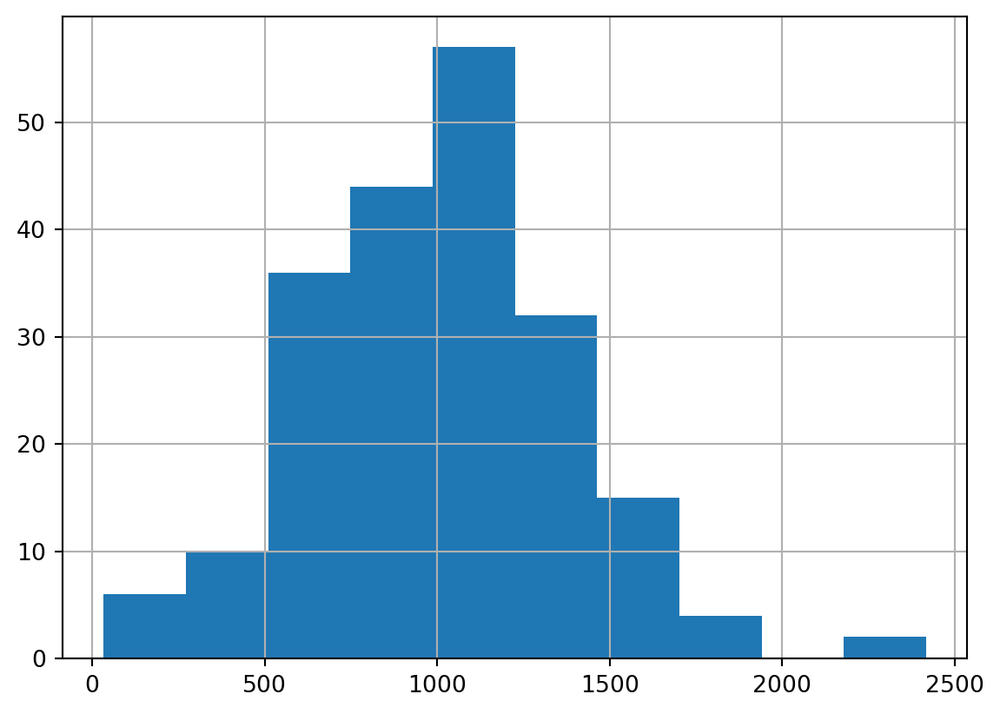

In [50]:
pd.Series(lag).hist()

<Axes: >

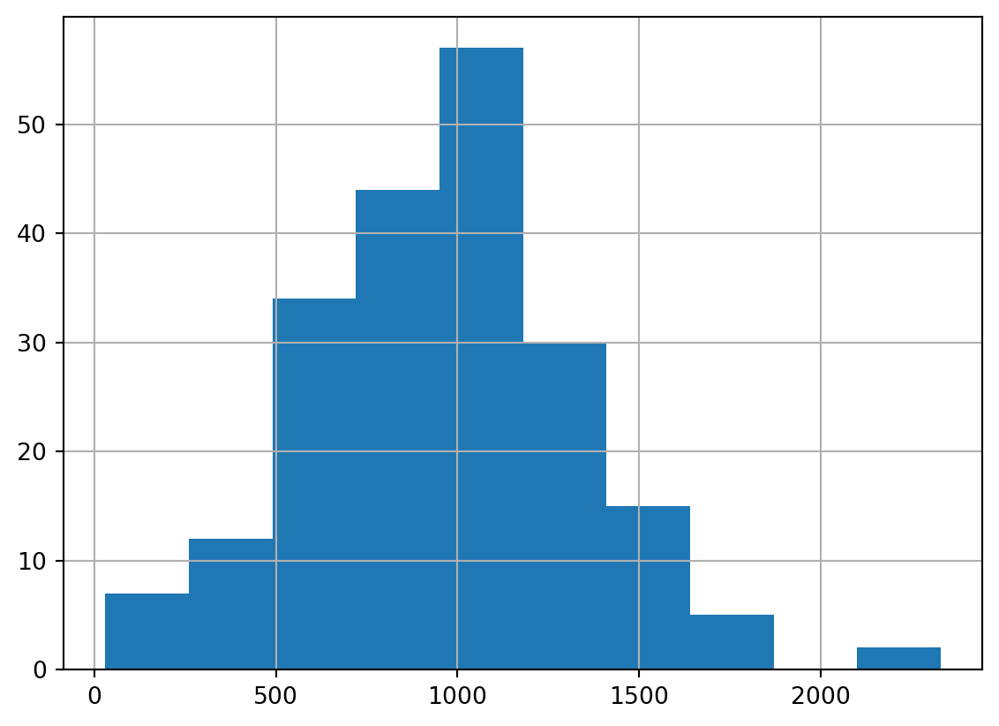

In [51]:
out_degree.hist()

In [52]:
pop_change = intra_commutes + in_degree - out_degree

<Axes: >

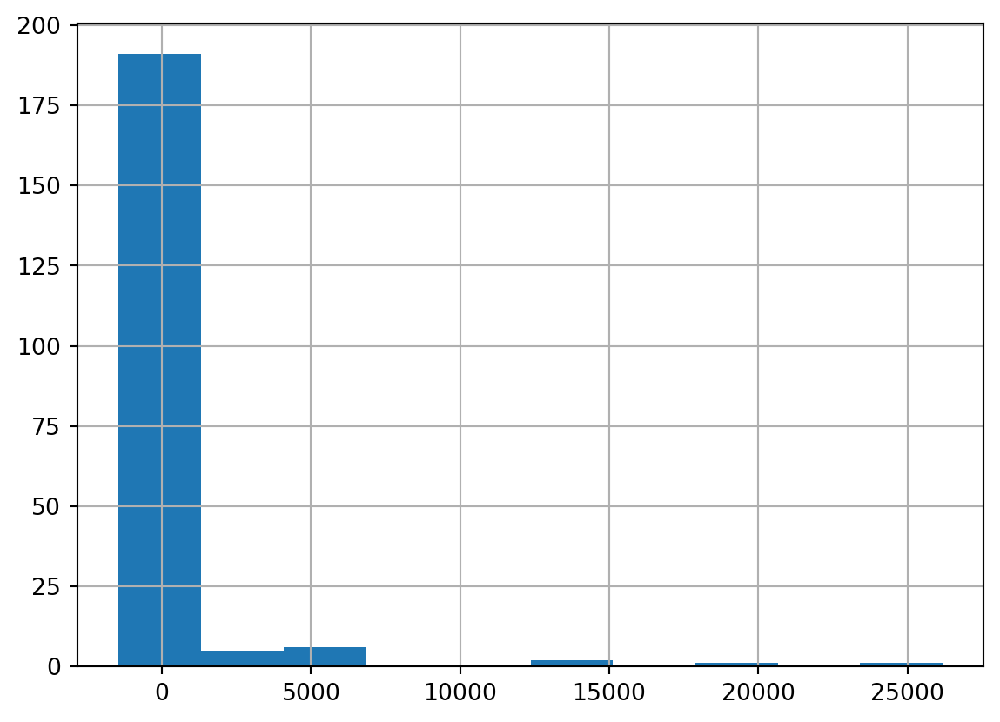

In [53]:
pop_change.hist()

In [54]:
# daily population change
# internal movers plus immigration minus emigration
intra_commutes + in_degree - out_degree

11001000101     -287.0
11001000102     2343.0
11001000201     4132.0
11001000202     1560.0
11001000300    -1092.0
                ...   
11001010900     -340.0
11001011001     -814.0
11001011002     -383.0
11001011100      295.0
11001980000    13076.0
Length: 206, dtype: float64

In [55]:
out_degree

11001000101    438
11001000102    738
11001000202    779
11001000703    547
11001000704    699
              ... 
11001009507    551
11001009905    852
11001009801    407
11001009906    454
11001009802    463
Name: out_degree, Length: 206, dtype: int64

In [56]:
out_degree.sum() + intra_commutes.sum() == all_commutes.sum()

np.True_

In [57]:
dc_flow_graph.adjacency.reset_index().groupby("neighbor").sum().sum()

focal     1100100010111001000102110010002021100100030011...
weight                                               206135
dtype: object

In [58]:
out_degree.sum()

np.int64(198753)

In [59]:
out_degree.sum() / all_commutes.sum()

np.float64(0.9641885172338516)

In [60]:
all_commutes.sum()

np.float64(206135.0)

<Axes: >

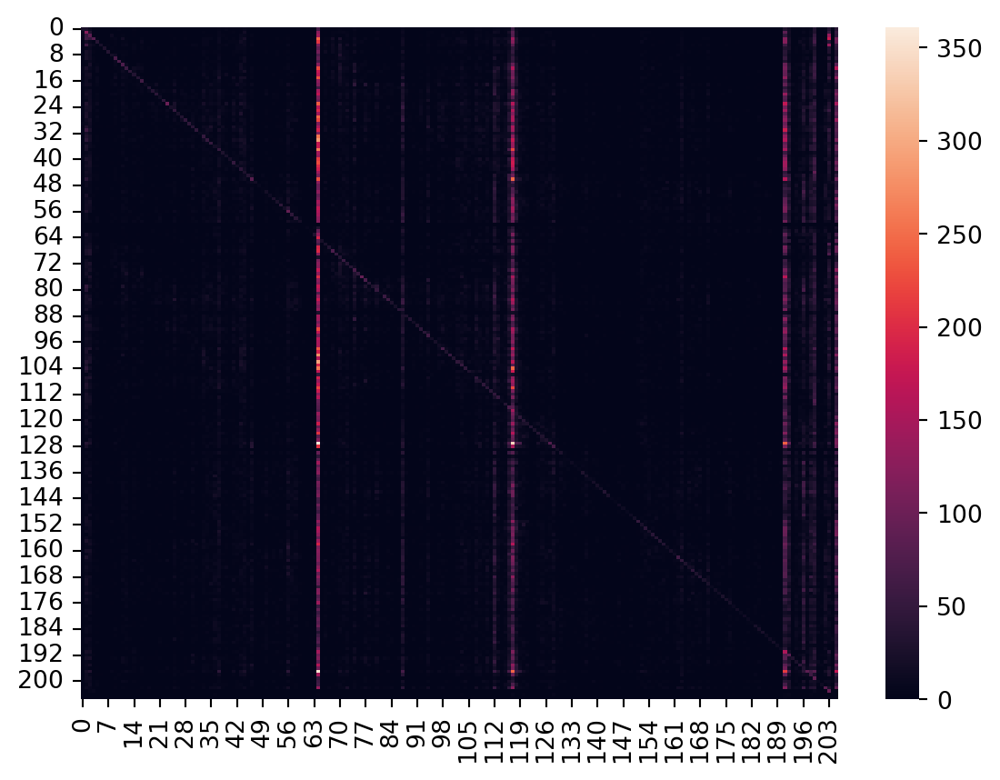

In [61]:
import seaborn as sns
sns.heatmap(dc_flow_graph.sparse.todense())

<Axes: >

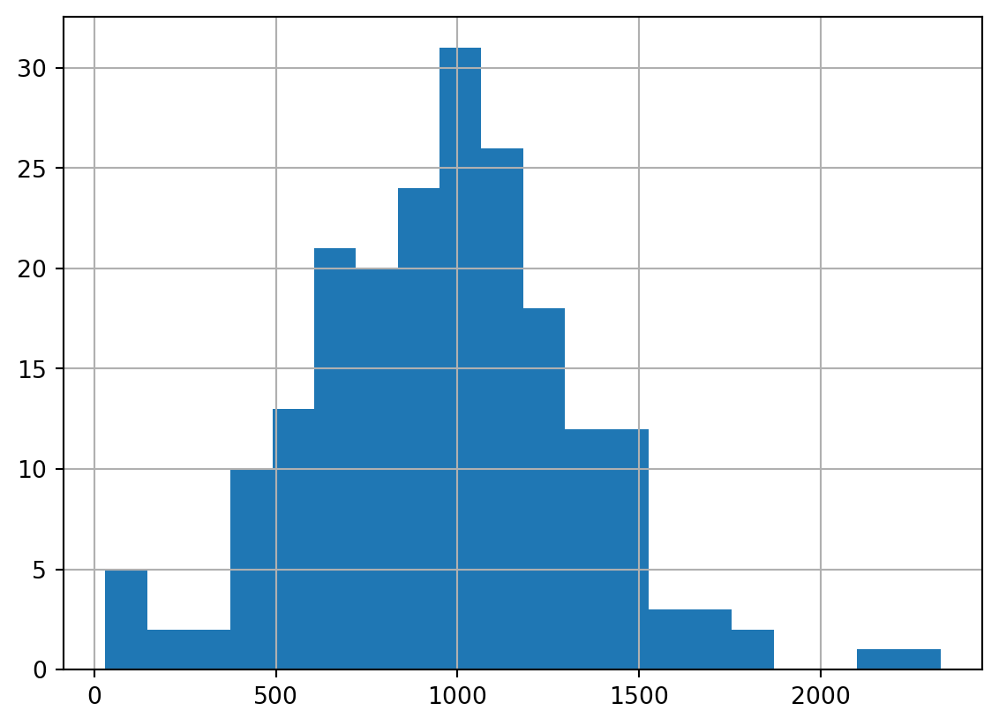

In [62]:
out_degree.hist(bins=20)

In [63]:
in_degree.sum()

np.int64(198753)

<Axes: >

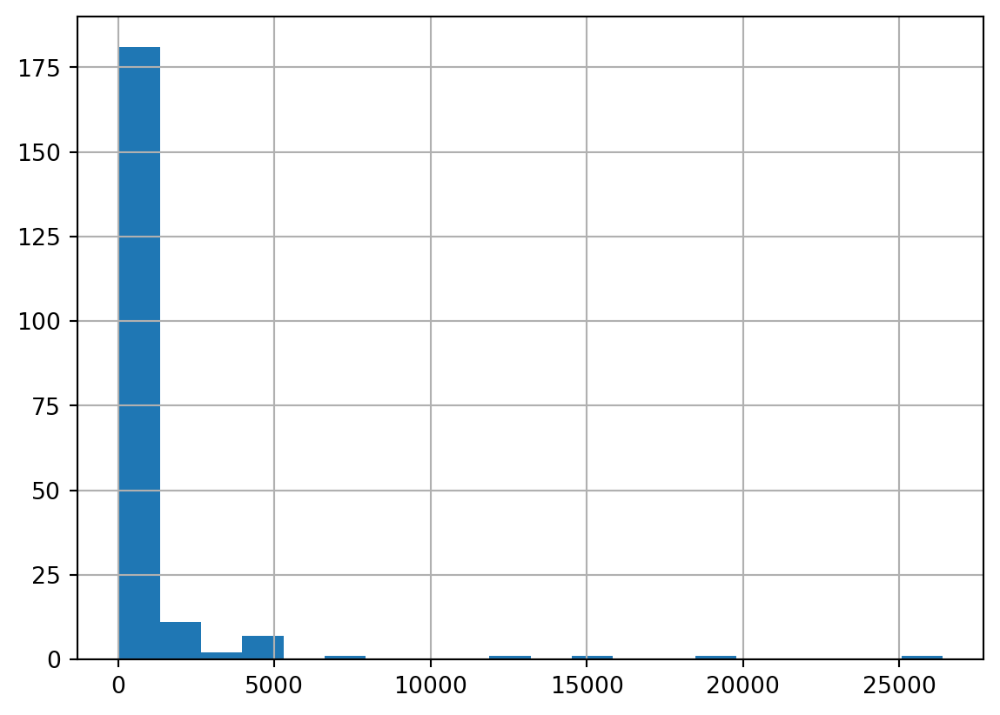

In [64]:
in_degree.hist(bins=20)

In [65]:
dc.join(out_degree, how="left").explore(
    "out_degree",
    style_kwds={"weight": 0.5},
    tiles="cartodb positron",
    tooltip="out_degree",
    scheme="fisherjenks",
)

In [66]:
dc.join(in_degree, how="left").explore(
    "in_degree",
    style_kwds={"weight": 0.5},
    linewidth=0.5,
    tiles="cartodb positron",
    tooltip="in_degree",
    scheme="fisherjenks",
)

<Axes: >

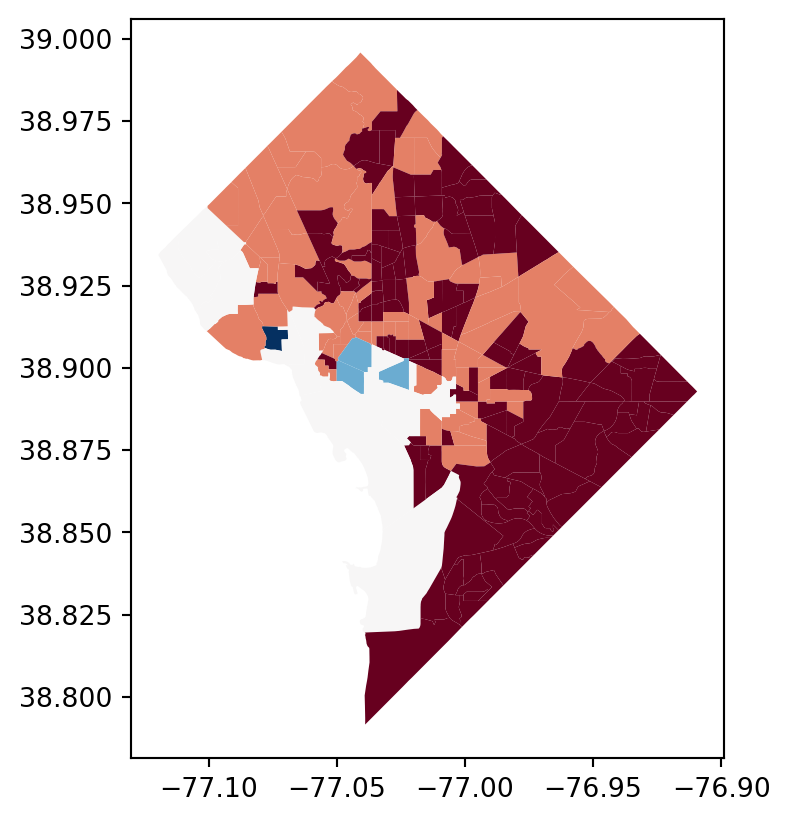

In [67]:
dc.join((out_degree / all_commutes).rename("out_share"), how="left").plot(
    "out_share",
    linewidth=0.5,
    #style_kwds={"weight": 0.5},
    #tiles="cartodb positron",
    #tooltip="out_share",
    scheme="fisherjenks",
    cmap="RdBu_r",
)

<Axes: >

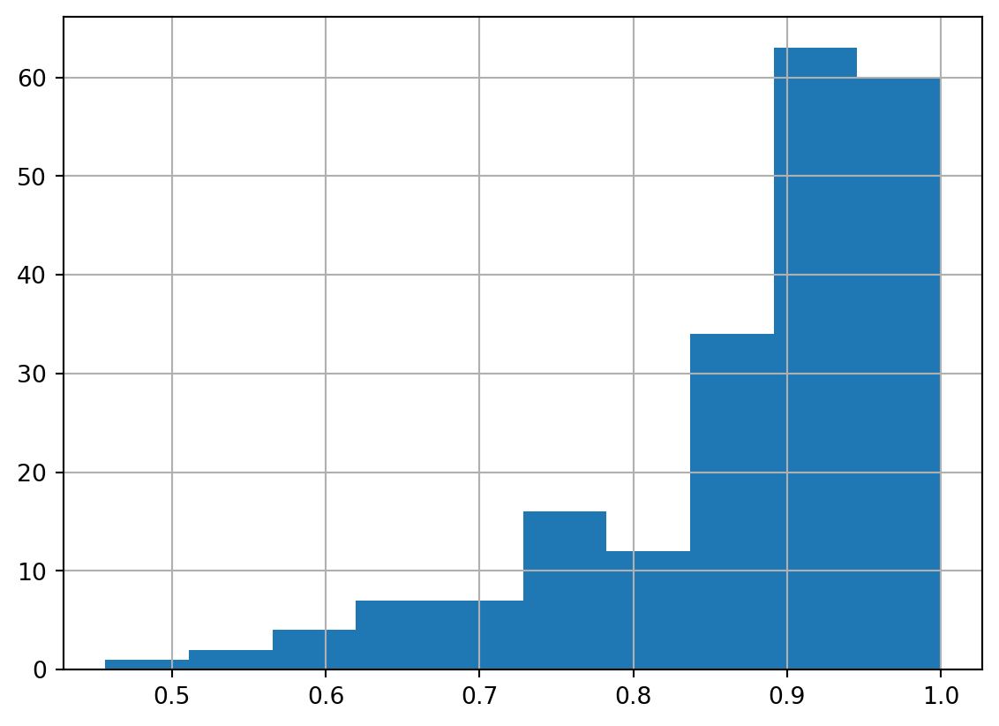

In [68]:
(in_degree / (intra_commutes + in_degree)).hist()

<Axes: >

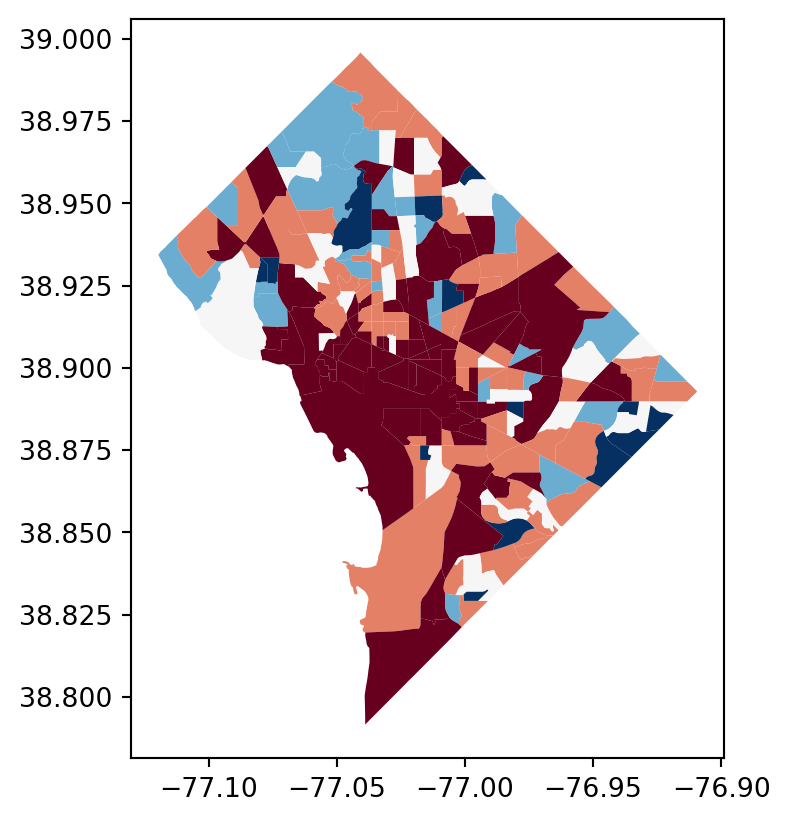

In [69]:
dc.join(
    (in_degree / (intra_commutes + in_degree)).rename("in_share"), how="left"
).plot(
    "in_share",
    #style_kwds={"weight": 0.5},
    #tiles="cartodb positron",
    #tooltip="in_share",
    linewidth=0.5,
    scheme="fisherjenks",
    cmap="RdBu_r",
)

<Axes: >

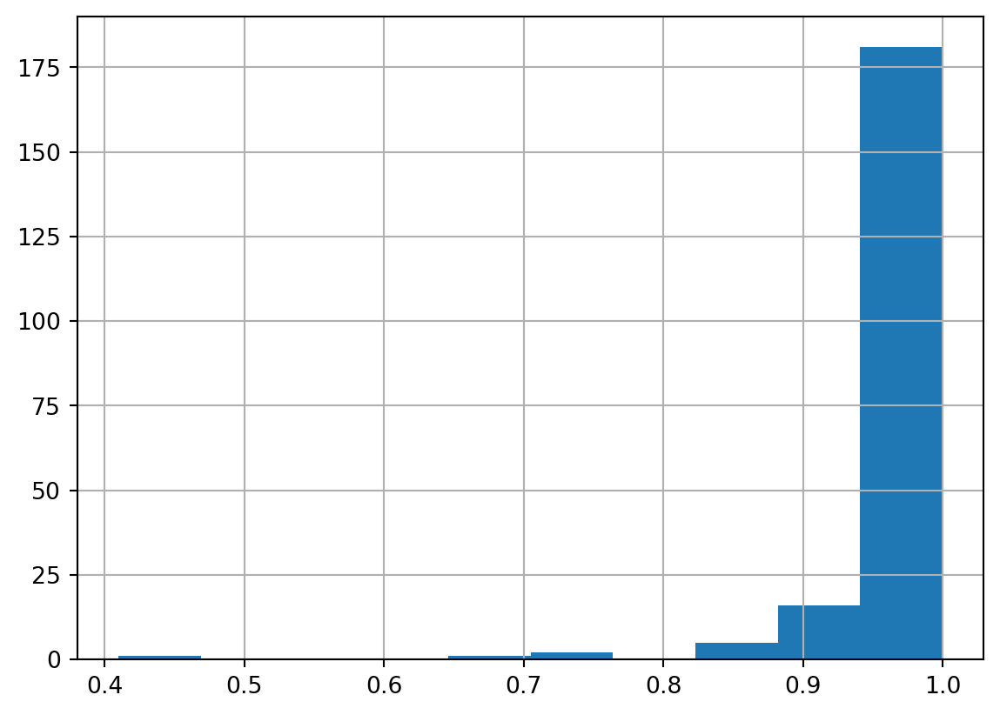

In [70]:
(out_degree / all_commutes).hist()

<Axes: >

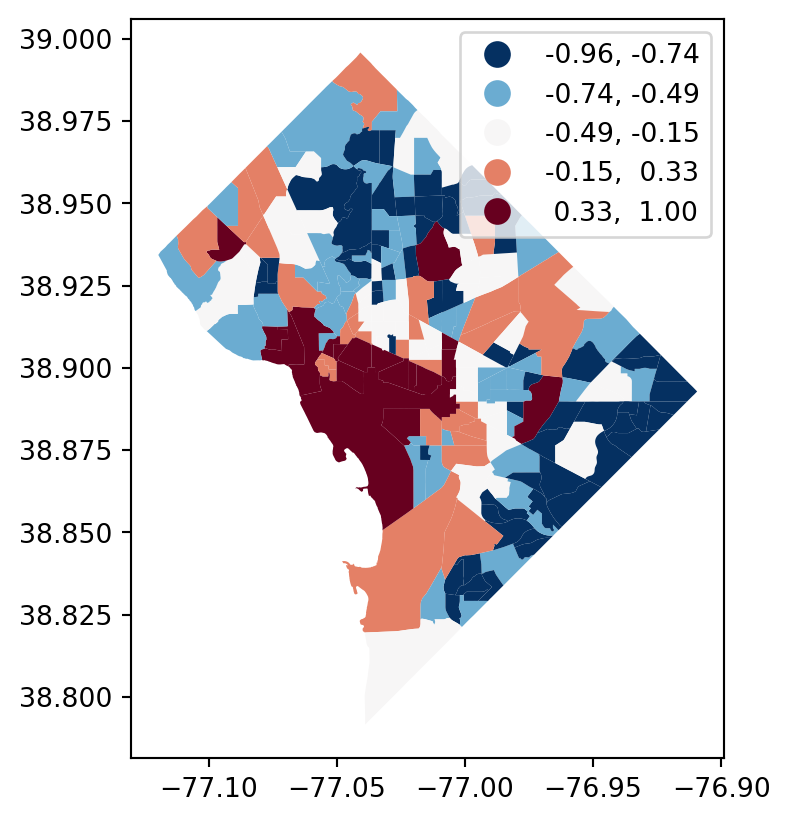

In [71]:
dc.join(((in_degree - out_degree) / degree).rename("diff"), how="left").plot(
    "diff",
    #style_kwds={"weight": 0.5},
    #tiles="cartodb positron",
    #tooltip="diff",
    linewidth=0.5,
    scheme="fisherjenks",
    cmap="RdBu_r",
    legend=True
)

In [72]:
out_degree / all_commutes

11001000101    0.952174
11001000102    0.857143
11001000201    0.409938
11001000202    0.902665
11001000300    0.947093
                 ...   
11001010900    0.986527
11001011001    0.975391
11001011002    0.977509
11001011100    0.943729
11001980000    0.909091
Length: 206, dtype: float64

In [73]:
dc_flow_graph = dc_flow_graph.assign_self_weight(0).eliminate_zeros()

In [74]:
# sparse representation
dc_interaction = (
    dc_flow_graph.assign_self_weight(0).eliminate_zeros().adjacency.reset_index()
)
dc_interaction

,focal,neighbor,weight
0,11001000101,11001000102,23
1,11001000101,11001000202,12
2,11001000101,11001000703,1
3,11001000101,11001000704,1
4,11001000101,11001000804,2
...,...,...,...
23096,11001980000,11001006900,1
23097,11001980000,11001009400,1
23098,11001980000,11001009510,2
23099,11001980000,11001010100,3


In [75]:
# for our dataset we want the full dense matrix
dc_interaction = pd.Series(dc_flow_graph.sparse.toarray().reshape(-1), 
                             index=pd.MultiIndex.from_product([dc_flow_graph.unique_ids, 
                                                               dc_flow_graph.unique_ids.rename('neighbor')])).rename('weight')

In [76]:
dc_interaction = dc_interaction.reset_index()
dc_interaction

,focal,neighbor,weight
0,11001000101,11001000101,0.0
1,11001000101,11001000102,23.0
2,11001000101,11001000202,12.0
3,11001000101,11001000300,0.0
4,11001000101,11001000501,0.0
...,...,...,...
42431,11001980000,11001011002,0.0
42432,11001980000,11001011100,0.0
42433,11001980000,11001000201,0.0
42434,11001980000,11001006804,0.0


In [77]:
# first merge origin attributes
dc_interaction = dc_interaction.merge(
    dc.drop(columns=["geometry"]), left_on="focal", right_index=True, how="left"
)

In [78]:
# now merge destination attributes
dc_interaction = dc_interaction.merge(
    dc.drop(columns=["geometry"]),
    left_on="neighbor",
    right_index=True,
    how="left",
    suffixes=["_origin", "_destination"],
)

In [79]:
dc_interaction

,focal,neighbor,weight,n_mexican_pop_origin,n_cuban_pop_origin,n_puerto_rican_pop_origin,n_russian_pop_origin,n_italian_pop_origin,n_german_pop_origin,n_irish_pop_origin,...,p_veterans_destination,p_poverty_rate_destination,p_poverty_rate_over_65_destination,p_poverty_rate_children_destination,p_poverty_rate_white_destination,p_poverty_rate_black_destination,p_poverty_rate_hispanic_destination,p_poverty_rate_native_destination,p_poverty_rate_asian_destination,year_destination
0,11001000101,11001000101,0.0,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,6.245121,2.341920,0.000000,0.000000,2.341920,0.000000,2.341920,0.000000,0.0,2021
1,11001000101,11001000102,23.0,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,6.073753,6.724512,1.487450,1.456461,4.834211,0.000000,0.000000,0.000000,0.0,2021
2,11001000101,11001000202,12.0,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,3.525424,12.948793,2.472042,0.000000,10.829900,0.588582,0.824014,0.000000,0.0,2021
3,11001000101,11001000300,0.0,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,0.838082,13.308750,0.301710,0.201140,12.504190,0.000000,0.620181,0.000000,0.0,2021
4,11001000101,11001000501,0.0,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,0.993571,8.556307,1.705381,0.000000,2.087621,6.380476,0.529256,0.000000,0.0,2021
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42431,11001980000,11001011002,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,9.414088,6.126617,3.335602,0.000000,6.126617,0.000000,0.000000,0.000000,0.0,2021
42432,11001980000,11001011100,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.466872,17.596308,1.645265,0.000000,0.521669,17.074639,0.100321,0.000000,0.0,2021
42433,11001980000,11001000201,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.177755,19.402985,0.000000,0.000000,16.417910,2.985075,0.000000,0.000000,0.0,2021
42434,11001980000,11001006804,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,2.166193,55.902778,31.597222,0.000000,11.805556,39.236111,2.083333,4.861111,0.0,2021


In [80]:
dc_interaction[
    ["weight", "median_household_income_origin", "median_household_income_destination"]
]

,weight,median_household_income_origin,median_household_income_destination
0,0.0,157276.0,157276.0
1,23.0,157276.0,166816.0
2,12.0,157276.0,161490.0
3,0.0,157276.0,159714.0
4,0.0,157276.0,109363.0
...,...,...,...
42431,0.0,NaN,110594.0
42432,0.0,NaN,74213.0
42433,0.0,NaN,NaN
42434,0.0,NaN,250001.0


In [81]:
dc = dc.to_crs(dc.estimate_utm_crs())

In [82]:
dc = dc[dc.index.isin(dc_flow_graph.unique_ids)]
dc_dist = Graph.build_distance_band(
    dc.set_geometry(dc.centroid), threshold=1e20, binary=False, alpha=1
)

In [83]:
dc_dist.summary()

Graph Summary Statistics
========================
Graph indexed by:
 ['11001000101', '11001000102', '11001000201', '1100100020...]
==============================================================
Number of nodes:                                           206
Number of edges:                                         42230
Number of connected components:                              1
Number of isolates:                                          0
Number of non-zero edges:                                42230
Percentage of non-zero edges:                           99.51%
Number of asymmetries:                            NA
--------------------------------------------------------------
Cardinalities
==============================================================
Mean:                     205    25%:                      205
Standard deviation:         0    50%:                      205
Min:                      205    75%:                      205
Max:                      205
--------------------------------------------------------------
Weights
==============================================================
Mean:                    6269    25%:                     3627
Standard deviation:      3403    50%:                     5817
Min:                      207    75%:                     8529
Max:                    19236
--------------------------------------------------------------
Sum of weights
==============================================================
S0:                                                  264750122
S1:                                               4297473688556
S2:                                               1435759541759836
--------------------------------------------------------------
Traces
==============================================================
GG:                                               2148736844278
G'G:                                              2148736844278
G'G + GG:                                         4297473688556

In [84]:
dc_dist.adjacency

focal        neighbor   
11001000101  11001000102     673.024487
             11001000201    1714.423693
             11001000202    1318.286816
             11001000300    2086.439842
             11001000400    1954.193812
                               ...     
11001980000  11001010800    2075.840579
             11001010900    7660.568101
             11001011001    1816.050530
             11001011002    1999.546509
             11001011100    7177.371175
Name: weight, Length: 42230, dtype: float64

In [85]:
# subset the distance graph by the travel graph (remove destinations we dont need)
# but this resets weights to 1
dc_dist_adj = dc_dist.intersection(dc_flow_graph).adjacency

In [86]:
# update with the old values
dc_dist_adj.update(dc_dist.adjacency)

/var/folders/j8/5bgcw6hs7cqcbbz48d6bsftw0000gp/T/ipykernel_31528/3611604903.py:2: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise an error in a future version of pandas. Value '[ 673.02448689 1714.42369324 1318.28681649 ... 7734.28131571 2519.49437645
  989.25225739]' has dtype incompatible with int8, please explicitly cast to a compatible dtype first.
  dc_dist_adj.update(dc_dist.adjacency)


In [87]:
dc_interaction["distance"] = dc_dist.sparse.toarray().reshape(-1)

In [88]:
dc_interaction['weight'] = dc_interaction['weight'].astype(int)

In [89]:
# mean-impute missing values
dc_interaction = dc_interaction.fillna(dc_interaction.mean(numeric_only=True))

# increment cols by 1 to make logs easier
dc_interaction['distance'] = dc_interaction['distance'] +1

dc_interaction['n_total_pop_origin'] = dc_interaction['n_total_pop_origin'] +1
dc_interaction['n_total__pop_destination'] = dc_interaction['n_total_pop_destination'] +1

dc_interaction['p_nonhisp_black_persons_origin'] = dc_interaction['p_nonhisp_black_persons_origin'] +1
dc_interaction['p_nonhisp_black_persons_destination'] = dc_interaction['p_nonhisp_black_persons_destination'] +1

dc_interaction = dc_interaction.copy()

/var/folders/j8/5bgcw6hs7cqcbbz48d6bsftw0000gp/T/ipykernel_31528/3950422283.py:8: PerformanceWarning: DataFrame is highly fragmented.  This is usually the result of calling `frame.insert` many times, which has poor performance.  Consider joining all columns at once using pd.concat(axis=1) instead. To get a de-fragmented frame, use `newframe = frame.copy()`
  dc_interaction['n_total__pop_destination'] = dc_interaction['n_total_pop_destination'] +1


In [90]:
dc_interaction

,focal,neighbor,weight,n_mexican_pop_origin,n_cuban_pop_origin,n_puerto_rican_pop_origin,n_russian_pop_origin,n_italian_pop_origin,n_german_pop_origin,n_irish_pop_origin,...,p_poverty_rate_over_65_destination,p_poverty_rate_children_destination,p_poverty_rate_white_destination,p_poverty_rate_black_destination,p_poverty_rate_hispanic_destination,p_poverty_rate_native_destination,p_poverty_rate_asian_destination,year_destination,distance,n_total__pop_destination
0,11001000101,11001000101,0,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,0.000000,0.000000,2.341920,0.000000,2.341920,0.000000,0.0,2021,1.000000,1282.0
1,11001000101,11001000102,23,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,1.487450,1.456461,4.834211,0.000000,0.000000,0.000000,0.0,2021,674.024487,3228.0
2,11001000101,11001000202,12,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,2.472042,0.000000,10.829900,0.588582,0.824014,0.000000,0.0,2021,1715.423693,4426.0
3,11001000101,11001000300,0,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,0.301710,0.201140,12.504190,0.000000,0.620181,0.000000,0.0,2021,1319.286816,5967.0
4,11001000101,11001000501,0,102.0,0.0,0.0,0.0,68.0,26.0,59.0,...,1.705381,0.000000,2.087621,6.380476,0.529256,0.000000,0.0,2021,2087.439842,3423.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
42431,11001980000,11001011002,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,3.335602,0.000000,6.126617,0.000000,0.000000,0.000000,0.0,2021,7661.568101,1520.0
42432,11001980000,11001011100,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.645265,0.000000,0.521669,17.074639,0.100321,0.000000,0.0,2021,1817.050530,5193.0
42433,11001980000,11001000201,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,0.000000,0.000000,16.417910,2.985075,0.000000,0.000000,0.0,2021,2000.546509,3939.0
42434,11001980000,11001006804,0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,31.597222,0.000000,11.805556,39.236111,2.083333,4.861111,0.0,2021,7178.371175,2817.0


In [91]:
g = Gravity(
    dc_interaction["weight"].values,
    o_vars=dc_interaction[["n_total_pop_origin", "median_household_income_origin", "p_nonhisp_black_persons_origin"]].values,
    d_vars=dc_interaction[
        ["n_total_pop_destination", "median_household_income_destination",  "p_nonhisp_black_persons_destination"]
    ]
    .values,
    cost=dc_interaction["distance"],
    cost_func="exp",
    constant=True,
).fit()

In [92]:
g.params

array([-1.30328257e+00,  6.72022888e-01,  1.40801006e-01,  4.76000489e-02,
       -2.84857860e-01, -4.83240629e-02, -4.79830945e-01, -2.88418095e-05])

In [93]:
g.adj_pseudoR2

np.float64(0.2064445085777441)

In [94]:
dc_interaction["distance"]

0           1.000000
1         674.024487
2        1715.423693
3        1319.286816
4        2087.439842
            ...     
42431    7661.568101
42432    1817.050530
42433    2000.546509
42434    7178.371175
42435       1.000000
Name: distance, Length: 42436, dtype: float64

In [95]:
g_statsmodels = smf.glm(
    "weight ~ 1 + np.log(n_total_pop_origin) + np.log(median_household_income_origin) + np.log(p_nonhisp_black_persons_origin) + np.log(n_total_pop_destination) + np.log(median_household_income_destination) + np.log(p_nonhisp_black_persons_destination) + distance",
    family=families.Poisson(),
    data=dc_interaction,).fit(cov_type='HC0', scale='X2')

In [96]:
g_statsmodels.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                 weight   No. Observations:                42436
Model:                            GLM   Df Residuals:                    42428
Model Family:                 Poisson   Df Model:                            7
Link Function:                    Log   Scale:                          28.247
Method:                          IRLS   Log-Likelihood:                -10249.
Date:                Mon, 21 Jul 2025   Deviance:                   5.0560e+05
Time:                        21:20:10   Pearson chi2:                 1.20e+06
No. Iterations:                     9   Pseudo R-squ. (CS):             0.1181
Covariance Type:                  HC0                                         
===============================================================================================================
                                                  coef    std err          z      P>|z|      [0.025      0.975]
---------------------------------------------------------------------------------------------------------------
Intercept                                      -1.3110      0.636     -2.063      0.039      -2.557      -0.065
np.log(n_total_pop_origin)                      0.6721      0.044     15.110      0.000       0.585       0.759
np.log(median_household_income_origin)          0.1408      0.029      4.817      0.000       0.084       0.198
np.log(p_nonhisp_black_persons_origin)          0.0476      0.018      2.660      0.008       0.013       0.083
np.log(n_total_pop_destination)                -0.2850      0.009    -31.810      0.000      -0.303      -0.267
np.log(median_household_income_destination)    -0.0478      0.033     -1.457      0.145      -0.112       0.016
np.log(p_nonhisp_black_persons_destination)    -0.4794      0.012    -38.890      0.000      -0.504      -0.455
distance                                    -2.884e-05   4.53e-06     -6.361      0.000   -3.77e-05      -2e-05
===============================================================================================================
"""

In [97]:
g.params.round(4)

array([-1.3033,  0.672 ,  0.1408,  0.0476, -0.2849, -0.0483, -0.4798,
       -0.    ])

In [98]:
out = g_statsmodels.params.rename("statsmdodels").to_frame().copy()
out["spint"] = g.params.T.round(4)

In [99]:
out

,statsmdodels,spint
Intercept,-1.311015,-1.3033
np.log(n_total_pop_origin),0.672147,0.6720
np.log(median_household_income_origin),0.140799,0.1408
np.log(p_nonhisp_black_persons_origin),0.047622,0.0476
np.log(n_total_pop_destination),-0.285020,-0.2849
np.log(median_household_income_destination),-0.047778,-0.0483
np.log(p_nonhisp_black_persons_destination),-0.479354,-0.4798
distance,-0.000029,-0.0000


In [100]:
mod_prod = Production(
    dc_interaction["weight"].values,
    dc_interaction["focal"].values,
    d_vars=dc_interaction[
        ["n_total_pop_destination", "median_household_income_destination", "p_nonhisp_black_persons_destination"]
    ]
    .values,
    cost=dc_interaction["distance"].values,
    cost_func="exp",
).fit()

In [101]:
mod_prod.params[-4:]

array([-2.84911877e-01, -5.07558277e-02, -4.80596880e-01, -3.39053694e-05])

In [102]:
mod_prod.adj_pseudoR2

np.float64(0.23213835591897392)

In [103]:
mod_prod_pow = Production(
    dc_interaction["weight"].values,
    dc_interaction["focal"].values,
    d_vars=dc_interaction[
        ["n_total_pop_destination", "median_household_income_destination", "p_nonhisp_black_persons_destination"]
    ]
    .values,
    cost=dc_interaction["distance"].values,
    cost_func="pow",
).fit()

In [104]:
mod_prod_pow.params[-4:]

array([-0.28759278, -0.04250044, -0.47854842, -0.03982813])

In [105]:
mod_prod_pow.adj_pseudoR2

np.float64(0.22975444627289543)

In [106]:
mod_attr = Attraction(
    flows=dc_interaction["weight"].values,
    destinations=dc_interaction["neighbor"].values,
    o_vars=dc_interaction[["n_total_pop_origin", "median_household_income_origin",  "p_nonhisp_black_persons_origin"]]
    .values,
    cost=dc_interaction["distance"].values,
    cost_func="exp",
)

In [107]:
attr_local = pd.DataFrame(mod_attr.local())

In [108]:
attr_local.columns

Index(['AIC', 'deviance', 'pseudoR2', 'adj_pseudoR2', 'D2', 'adj_D2', 'SSI',
       'SRMSE', 'param0', 'stde0', 'pvalue0', 'tvalue0', 'param1', 'stde1',
       'pvalue1', 'tvalue1', 'param2', 'stde2', 'pvalue2', 'tvalue2', 'param3',
       'stde3', 'pvalue3', 'tvalue3'],
      dtype='object')

In [109]:
dc.assign(dist=attr_local['param3'].values).explore('dist', scheme='quantiles', tooltip='dist',  cmap='RdBu_r',   style_kwds={"weight": 0.5},
 tiles='cartodb positron')

In [110]:
mod_attr.fit()

In [111]:
mod_attr.params[-4:]

array([ 6.74477248e-01,  1.45735531e-01,  4.61204174e-02, -1.19007021e-05])

In [112]:
mod_attr.pseudoR2

np.float64(0.7394749340844884)

In [113]:
# attraction-constrained
a_statsmodels = smf.glm(
    "weight ~ 1 + I(neighbor) + np.log(n_total_pop_origin) + np.log(median_household_income_origin) + np.log(p_nonhisp_black_persons_origin) + distance",
    family=families.Poisson(),
    data=dc_interaction
).fit()

In [114]:
a_statsmodels.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                 weight   No. Observations:                42436
Model:                            GLM   Df Residuals:                    42226
Model Family:                 Poisson   Df Model:                          209
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -94971.
Date:                Mon, 21 Jul 2025   Deviance:                   1.1656e+05
Time:                        21:20:13   Pearson chi2:                 1.32e+05
No. Iterations:                     8   Pseudo R-squ. (CS):              1.000
Covariance Type:            nonrobust                                         
==========================================================================================================
                                             coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------------------
Intercept                                 -7.7468      0.120    -64.487      0.000      -7.982      -7.511
I(neighbor)[T.11001000102]                 3.1373      0.090     34.880      0.000       2.961       3.314
I(neighbor)[T.11001000201]                 3.4699      0.089     38.804      0.000       3.295       3.645
I(neighbor)[T.11001000202]                 2.8744      0.091     31.750      0.000       2.697       3.052
I(neighbor)[T.11001000300]                 0.7745      0.107      7.265      0.000       0.566       0.983
I(neighbor)[T.11001000400]                 1.4074      0.098     14.335      0.000       1.215       1.600
I(neighbor)[T.11001000501]                 1.1021      0.102     10.826      0.000       0.903       1.302
I(neighbor)[T.11001000502]                 0.3071      0.116      2.649      0.008       0.080       0.534
I(neighbor)[T.11001000600]                 1.4798      0.098     15.175      0.000       1.289       1.671
I(neighbor)[T.11001000702]                -0.9011      0.164     -5.485      0.000      -1.223      -0.579
I(neighbor)[T.11001000703]                -1.4589      0.203     -7.198      0.000      -1.856      -1.062
I(neighbor)[T.11001000704]                -0.6504      0.151     -4.319      0.000      -0.946      -0.355
I(neighbor)[T.11001000802]                 0.6872      0.108      6.373      0.000       0.476       0.899
I(neighbor)[T.11001000803]                 0.6246      0.109      5.713      0.000       0.410       0.839
I(neighbor)[T.11001000804]                 1.0396      0.103     10.127      0.000       0.838       1.241
I(neighbor)[T.11001000902]                 0.2520      0.118      2.139      0.032       0.021       0.483
I(neighbor)[T.11001000903]                 2.2282      0.093     24.048      0.000       2.047       2.410
I(neighbor)[T.11001000904]                 1.7655      0.095     18.540      0.000       1.579       1.952
I(neighbor)[T.11001001002]                 2.1743      0.093     23.408      0.000       1.992       2.356
I(neighbor)[T.11001001003]                -0.0901      0.127     -0.709      0.479      -0.339       0.159
I(neighbor)[T.11001001004]                 1.8086      0.095     19.019      0.000       1.622       1.995
I(neighbor)[T.11001001100]                 2.5528      0.091     27.937      0.000       2.374       2.732
I(neighbor)[T.11001001200]                 1.6829      0.096     17.518      0.000       1.495       1.871
I(neighbor)[T.11001001301]                -0.1733      0.131     -1.322      0.186      -0.430       0.084
I(neighbor)[T.11001001303]                 1.2923      0.100     12.960      0.000       1.097       1.488
I(neighbor)[T.11001001304]                 0.6917      0.109      6.365      0.000     

In [115]:
mod_attr.pseudoR2

np.float64(0.7394749340844884)

In [116]:
mod_attr.params[-4:].round(4)

array([ 0.6745,  0.1457,  0.0461, -0.    ])

In [117]:
a_statsmodels.params[-4:]

np.log(n_total_pop_origin)                0.680187
np.log(median_household_income_origin)    0.147455
np.log(p_nonhisp_black_persons_origin)    0.046415
distance                                 -0.000012
dtype: float64

In [118]:
# mcfadden
1 - (a_statsmodels.llf / a_statsmodels.llnull)

np.float64(0.7396697682685844)

In [119]:
# cohen
(a_statsmodels.null_deviance - a_statsmodels.deviance) / a_statsmodels.null_deviance

np.float64(0.822375364673833)

In [120]:
# CS
1 - np.exp((2 / a_statsmodels.nobs) * (a_statsmodels.llnull - a_statsmodels.llf))

np.float64(0.9999970016617493)

In [121]:
a_statsmodels.pseudo_rsquared()

np.float64(0.9999970016617493)

In [122]:
d = Doubly(
    dc_interaction["weight"].values,
    dc_interaction["focal"].values,
    dc_interaction["neighbor"].values,
    cost=dc_interaction["distance"],
    cost_func="exp",
).fit()

In [123]:
d.adj_pseudoR2

np.float64(0.7644170768314439)

In [124]:
d.params[-1:].round(5)

array([-2.e-05])

In [125]:
d_statsmodels = smf.glm(
    "weight ~ 1 + C(focal) + C(neighbor) + distance",
    family=families.Poisson(),
    data=dc_interaction
).fit()

In [126]:
d_statsmodels.summary()

<class 'statsmodels.iolib.summary.Summary'>
"""
                 Generalized Linear Model Regression Results                  
==============================================================================
Dep. Variable:                 weight   No. Observations:                42436
Model:                            GLM   Df Residuals:                    42024
Model Family:                 Poisson   Df Model:                          411
Link Function:                    Log   Scale:                          1.0000
Method:                          IRLS   Log-Likelihood:                -85400.
Date:                Mon, 21 Jul 2025   Deviance:                       97423.
Time:                        21:20:18   Pearson chi2:                 1.16e+05
No. Iterations:                     8   Pseudo R-squ. (CS):              1.000
Covariance Type:            nonrobust                                         
==============================================================================================
                                 coef    std err          z      P>|z|      [0.025      0.975]
----------------------------------------------------------------------------------------------
Intercept                     -1.1748      0.100    -11.723      0.000      -1.371      -0.978
C(focal)[T.11001000102]        0.5283      0.060      8.759      0.000       0.410       0.647
C(focal)[T.11001000201]       -1.8993      0.132    -14.384      0.000      -2.158      -1.640
C(focal)[T.11001000202]        0.6000      0.060     10.044      0.000       0.483       0.717
C(focal)[T.11001000300]        1.2141      0.055     22.265      0.000       1.107       1.321
C(focal)[T.11001000400]        0.0840      0.066      1.269      0.205      -0.046       0.214
C(focal)[T.11001000501]        1.0136      0.056     18.091      0.000       0.904       1.123
C(focal)[T.11001000502]        0.8584      0.057     15.046      0.000       0.747       0.970
C(focal)[T.11001000600]        0.9553      0.056     16.992      0.000       0.845       1.066
C(focal)[T.11001000702]        0.8953      0.057     15.732      0.000       0.784       1.007
C(focal)[T.11001000703]        0.2330      0.064      3.634      0.000       0.107       0.359
C(focal)[T.11001000704]        0.4880      0.061      8.007      0.000       0.369       0.607
C(focal)[T.11001000802]        0.5885      0.060      9.886      0.000       0.472       0.705
C(focal)[T.11001000803]        0.1124      0.066      1.693      0.090      -0.018       0.242
C(focal)[T.11001000804]        0.4014      0.062      6.449      0.000       0.279       0.523
C(focal)[T.11001000902]        0.1208      0.066      1.821      0.069      -0.009       0.251
C(focal)[T.11001000903]       -0.6744      0.082     -8.198      0.000      -0.836      -0.513
C(focal)[T.11001000904]        0.3101      0.063      4.939      0.000       0.187       0.433
C(focal)[T.11001001002]        0.5863      0.060      9.851      0.000       0.470       0.703
C(focal)[T.11001001003]        0.5258      0.060      8.742      0.000       0.408       0.644
C(focal)[T.11001001004]        0.8352      0.058     14.500      0.000       0.722       0.948
C(focal)[T.11001001100]        0.9782      0.056     17.474      0.000       0.868       1.088
C(focal)[T.11001001200]        1.2291      0.055     22.499      0.000       1.122       1.336
C(focal)[T.11001001301]        0.9887      0.056     17.516      0.000       0.878       1.099
C(focal)[T.11001001303]        0.8587      0.058     14.917      0.000       0.746       0.972
C(focal)[T.11001001304]        1.1985      0.055     21.716      0.000       1.090       1.307
C(focal)[T.11001001401]        0.6707      0.059     11.441      0.000       0.556       0.786
C(focal)[T.11001001402]        0.6937      0.059     11.692      0.000       0.577       0.810
C(focal)[T.11001001500]        1.1106      0.055     20.192      0.000       1.003       1.218
C(focal)[T.11001001600]        0.9158      

In [127]:
d.params[-1:]

array([-1.95256086e-05])

In [128]:
d_statsmodels.params[-1]

/var/folders/j8/5bgcw6hs7cqcbbz48d6bsftw0000gp/T/ipykernel_31528/3503717071.py:1: FutureWarning: Series.__getitem__ treating keys as positions is deprecated. In a future version, integer keys will always be treated as labels (consistent with DataFrame behavior). To access a value by position, use `ser.iloc[pos]`
  d_statsmodels.params[-1]


np.float64(-1.953566583722616e-05)